In [2]:
# activate package, basic imports + load data
include("/Users/federicoclaudi/Documents/Github/LocomotionControl/analysis/behavior/analysis_fixtures.jl")
include("/Users/federicoclaudi/Documents/Github/LocomotionControl/analysis/behavior/analysis_visuals.jl")
using HypothesisTests
using Random , GLM

import jcontrol: movingaverage
import jcontrol as jc

using GLM
import DataFrames: dropmissing
using Lathe.preprocess: TrainTestSplit


  Activating project at `~/Documents/Github/LocomotionControl/analysis/behavior`


@Info (Main):  Loaded 1021 trials 
  ╰──────────────────────────────────────────────── 


                      Fri, 20 May 2022 16:00:14 
@Info (Main):  After tortuosity analysis, discarded 9.109% of trials | 928

 
  │                trials left 
  ╰──────────────────────────────────────────────── 
                      Fri, 20 May 2022 16:00:17 


## Get time of slowing/turning

In [3]:
# initialize empty data store
function initialize_df()
    return Dict(
        "curve_id" => [],
        "class" => [],  # slowing down/turning
        "x" => [],
        "y" => [],
        "s" => [],
        "u" => [],
        "ω" => [],
        "u̇" => [],
        "t0" => [],
        "tpeak" => [],
        "t1" => [],
        "trial_num" => [],
    )
end


function append_data(data_df, trial, I, cidx, class, u̇, t0, tpeak, t1, trial_num)
    push!(data_df["curve_id"], cidx)
    push!(data_df["class"], class)
    push!(data_df["x"], trial.x[I-1])
    push!(data_df["y"], trial.y[I-1])
    push!(data_df["s"], trial.s[I-1])
    push!(data_df["u"], mean(trial.u[I-6:I+5]))
    push!(data_df["ω"], mean(trial.ω[I-6:I+5]))
    push!(data_df["u̇"], u̇ * 60)
    push!(data_df["t0"], t0)
    push!(data_df["tpeak"], tpeak)
    push!(data_df["t1"], t1)
    push!(data_df["trial_num"], trial_num)
end


# get when the mice start slowing down
function get_start_slowing_down(trials, data_df)
    plots = []

    kept = 0
    for cidx in 1:length(curves)
        curve = curves[cidx]
        s0 = curve.s0
        s1 = curve.s
        
        plt = plot()
    
        peaks_s, peaks_values = [], []
        for tn in 1:length(trials)
            trial = trials[tn]
            idxs, idx = get_curve_indices(trial, s0, s1)
    
            u = movingaverage(trial.u, SMOOTHING_WINDOW_LEN)[idxs]
    
            _idxs, _ = get_curve_indices(trial, s0, curve.sf)
            plot!(trial.s[idxs], u, color="black", alpha=.1, label=nothing)
    
            duration = length(u) / 60
            (duration > curve.maxdur || duration < .3) && continue
    
            switchpoint = argmax(u)
            I = switchpoint + idx
            I = max(I, 10)
    
            # get additional info
            info = Dict(
                "mean_u̇" => mean(diff(u[switchpoint:end]))
            )
    
            u̇ = mean(diff(filter(!isnan, u[switchpoint:end])))
            append_data(data_df, trial, I, cidx, "slowing", u̇, idx, I-1, idx+length(u), tn)
            push!(peaks_s, trial.s[I-1])
            push!(peaks_values, trial.u[I-1])
            kept += 1
        end
    
        # scatter position of u̇ peaks
        scatter!(
            peaks_s, peaks_values, color="red", label=nothing, alpha=1
        )
        plot!([s0, s0], [-10, 100], lw=2, color="blue", label="s0", title="Curve $cidx")
        plot!([curve.s, curve.s], [-10, 100], lw=2, color="green", label="apex")
        plot!([curve.sf, curve.sf], [-10, 100], lw=2, color="red", label="curve end")
        push!(plots, plt)
    end
    
    
    
    @info "Kept $kept trials/curves combos"
    return plot(
        plots...; size=(1200, 1000)
    )
end


function get_start_of_turning(trials, data_df)
    plots = []
    kept = 0
    for cidx in 1:length(curves)
        curve = curves[cidx]
        s0 = curve.s0
        s1 = curve.s
        
        plt = plot()

        peaks_s, peaks_values = [], []
        for tn in 1:length(trials)
            trial = trials[tn]
            idxs, idx = get_curve_indices(trial, s0, s1)

            s = movingaverage(trial.s[idxs], SMOOTHING_WINDOW_LEN)
            ω = movingaverage(trial.ω[idxs], SMOOTHING_WINDOW_LEN) .* curve.direction
            plot!(trial.s[idxs], ω, color="black", alpha=.1, label=nothing)

            duration = length(ω) / 60
            (duration > curve.maxdur || duration < .3) && continue

            # get when it starts turning
            th = 2.0
            switchpoint = nothing
            while isnothing(switchpoint) && th > 0
                switchpoint = findfirst((ω .> th) .& (s .> curve.tpos))
                th -= .05
            end

            t0 = findfirst(s .> curve.tpos)
            I = switchpoint + idx

            append_data(data_df, trial, I, cidx, "turning", 0.0, idx+t0, I-1, idx+length(ω), tn)
            push!(peaks_s, trial.s[I-1])
            push!(peaks_values, trial.ω[I-1] * curve.direction)
            kept += 1
        end

        # scatter position of u̇ peaks
        scatter!(
            peaks_s, peaks_values, color="red", label=nothing, alpha=1
        )
        plot!([s0, s0], [-10, 10], lw=2, color="blue", label="s0")

        plot!([curve.s, curve.s], [-10, 10], lw=2, color="green", label="curve", title="Curve $cidx", xlim=[s0, s1], ylim=[-12, 12])
        plot!([curve.tpos, curve.tpos], [-10, 10], lw=2, color="red", label="turn s0")

        hline!([1.5], color="black", lw=2)

        push!(plots, plt)
    end

    @info "Kept $kept trials/curves combos"

    return plot(
        plots..., size=(1200, 1000)
    )

end



get_start_of_turning (generic function with 1 method)

In [4]:
SMOOTHING_WINDOW_LEN = 6


# collect data
data_df = initialize_df()
p1 = get_start_slowing_down(trials, data_df)
p2 = get_start_of_turning(trials, data_df)

# put data together
df = DataFrame(data_df)
df[!,:class] = convert.(String,df[!,:class])

for col in (:curve_id, :t0, :t1, :tpeak, :trial_num)
    df[!,col] = convert.(Int,df[!,col])
end

for col in (:x, :y, :s, :u, :ω, :u̇)
    df[!, col] = convert.(Float64, df[!, col])
end

# display(p1)
# display(p2)

nothing

@Info (Main.get_start_slowing_down):  Kept 3668 trials/curves combos 
  ╰──────────────────────────────────────────────── 
                      Fri, 20 May 2022 16:00:52 
@Info (Main.get_start_of_turning):  Kept 3668 trials/curves combos

 
  ╰──────────────────────────────────────────────── 
                      Fri, 20 May 2022 16:00:57 


# F4
Plot accceleration during turn and how much worse it would be if mice didn't slow down

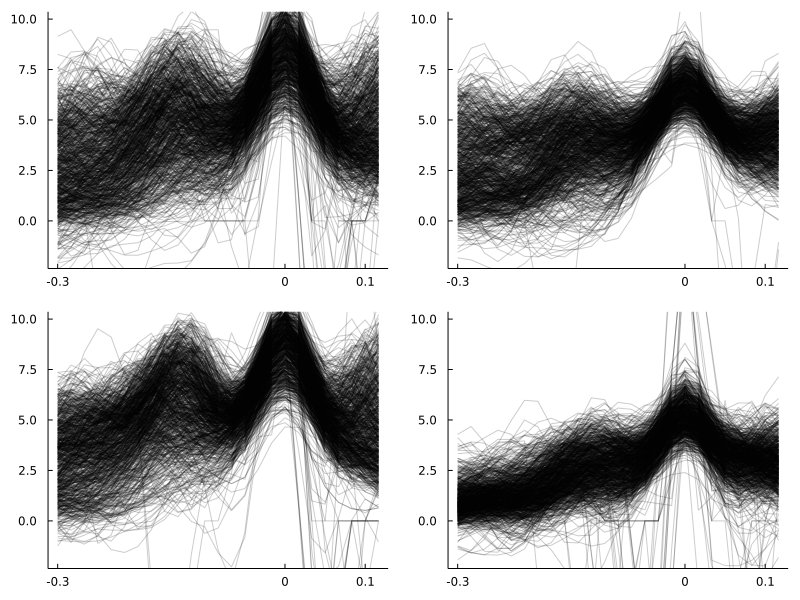

In [5]:
import jcontrol: Δ, movingaverage

"""
Get average angular acceleration in the 20 frames (.3s)
before reaching peak angular velocity
"""

plots = []
mean_ω̇ = []
for (i, curve) in enumerate(curves)
    slowing = filterdf(df, "curve_id", i, "class", "slowing")

    plt = plot(; grid=false, ylim=[-2, 10], xticks=([1, 18, 24], ["-0.3", "0", "0.1"]))

    curve_mean_ω̇ = []
    for (n, trial) in enumerate(trials)
        n ∈ slowing.trial_num || continue
        _, _, start, stop = get_curve_indices(trial, curve.tpos, curve.sf)

        ω = movingaverage(trial.ω, 2) .* curve.direction
        t = argmax(ω[start:stop]) + start
        # max(ω...) > 20 && continue
        plot!(ω[max(1, t-18):t+6], label=nothing, color="black", alpha=.2)

        push!(curve_mean_ω̇, mean(Δ(ω[max(1, t-20):t])) * 60 * 60)
    end
    push!(mean_ω̇, curve_mean_ω̇)
    push!(plots, plt)
end

plot(plots...; size=(800, 600), link=:all, grid=false)

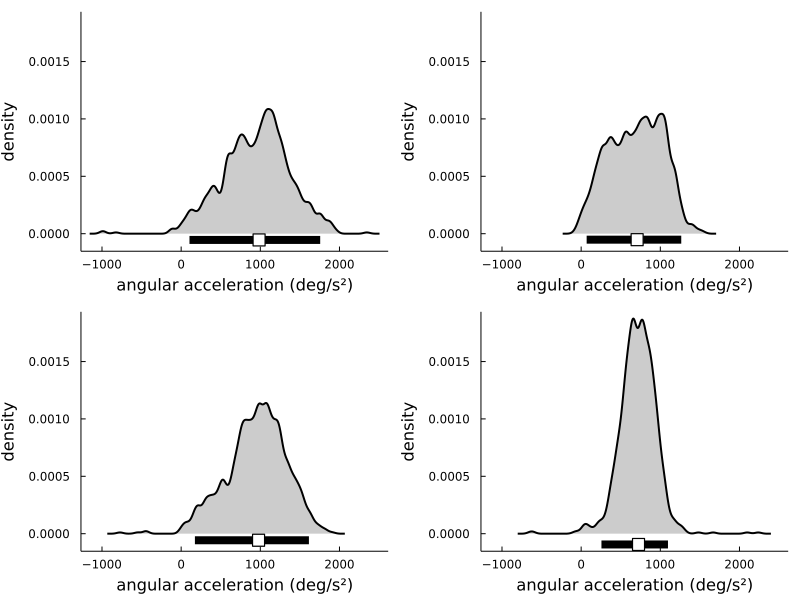

In [6]:
# plot KDEs of angular velocity distributions
plots = []

for curve_mean_ω̇ in mean_ω̇
    plt = plot(; grid=false, )
    plot_kde_and_CI!(curve_mean_ω̇, bandwidth = 40)
    plot!( xlabel="angular acceleration (deg/s²)", ylabel="density")
    push!(plots, plt)
end

fig = plot(plots...; size=(800, 600), link=:all, grid=false)
savefig(fig, joinpath(PLOTS_FOLDER, "physics_accelerations.svg"))

fig

plot the change in speed between slowing and turning

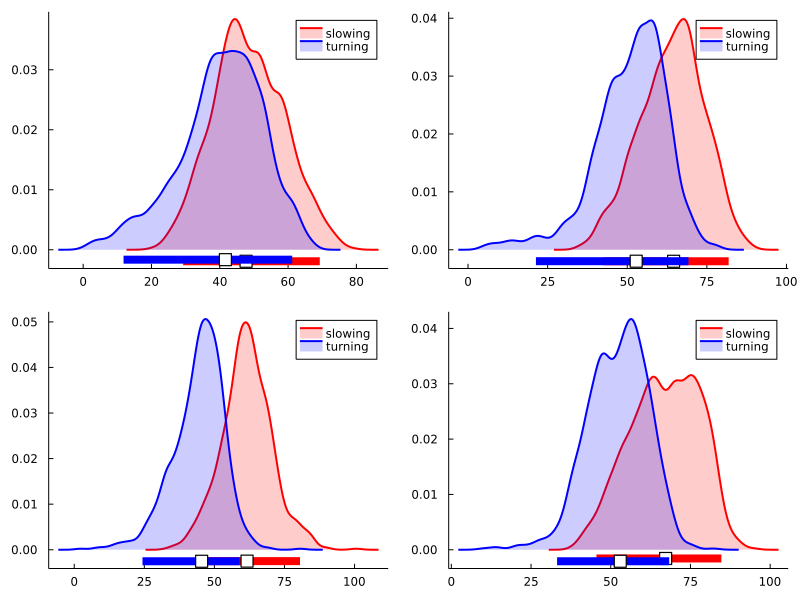

In [7]:
plots = []
speeds_ratios = []
for curve_idx in 1:4
    slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    turning = filterdf(df, "curve_id", curve_idx, "class", "turning")

    # turning = filter(:u̇ => !isnan, turning)
    # slowing = filter(:u̇ => !isnan, slowing)

    prev_u̇ = []
    for slow in eachrow(slowing)
    t0 = max(1, slow.t0-5)
    push!(prev_u̇, mean(diff(trials[slow.trial_num].u)[t0:slow.t0]))
    end

    dt = (turning.tpeak .- slowing.tpeak)
    top_speed = slowing.u .+ prev_u̇ .* dt

    # plt = plot_kde_and_CI(top_speed, bandwidth = 3, color="black", label="no slowing")
    plt = plot_kde_and_CI(slowing.u, bandwidth = 2, color="red", label="slowing")

    plot_kde_and_CI!(turning.u, bandwidth = 2, color="blue", label="turning")
    # plot!(; xlabel="speed cm/s", ylabel="density", title="Curve $curve_idx", legend=true, xlim=[0, 100])

    push!(plots, plt)

    # get speeds ratios
    push!(speeds_ratios, turning.u ./ slowing.u)
end

fig = plot(plots...; size=(800, 600), grid=false)
savefig(fig, joinpath(PLOTS_FOLDER, "physics_speeds.svg"))
fig

compare actual angular acceleration to change if they hadn't slowed down

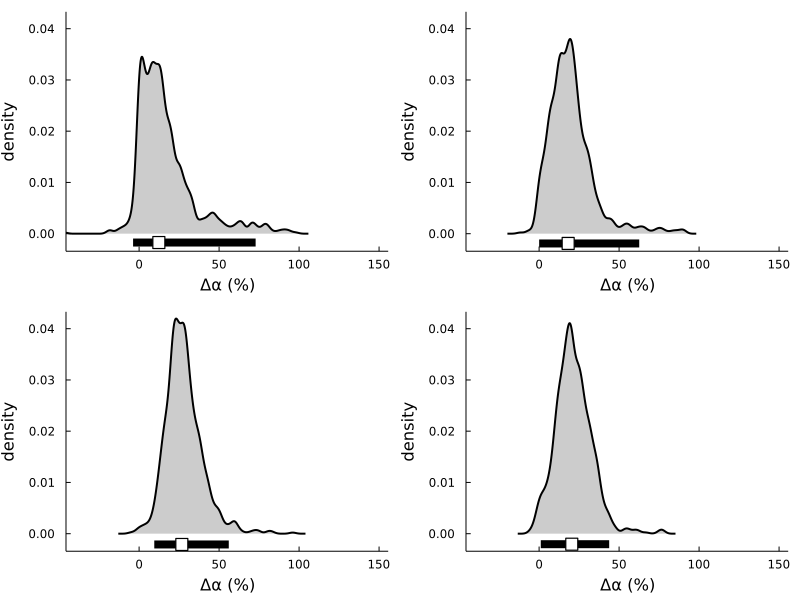

In [8]:
plots = []
for k in 1:4
    α_s = mean_ω̇[k] .* speeds_ratios[k]

    plt = plot(xlim=[-40, 150])

    plot_kde_and_CI!( (1 .- speeds_ratios[k]) * 100, bandwidth = 2)
    # plot_kde_and_CI!(mean_ω̇[k], bandwidth = .5, label="α_t")
    # plot_kde_and_CI!(α_s, bandwidth = .5, label="α_s", color="red")
    push!(plots, plt)
end
fig = plot(plots...; size=(800, 600), link=:all, grid=false, xlabel="Δα (%)", ylabel="density")
savefig(fig, joinpath(PLOTS_FOLDER, "physics_accelerations_delta.svg"))
fig

#### Counterfactual
Get the distance from the apex and speed at moment of start turning to compute how much time the mice have to turn. 

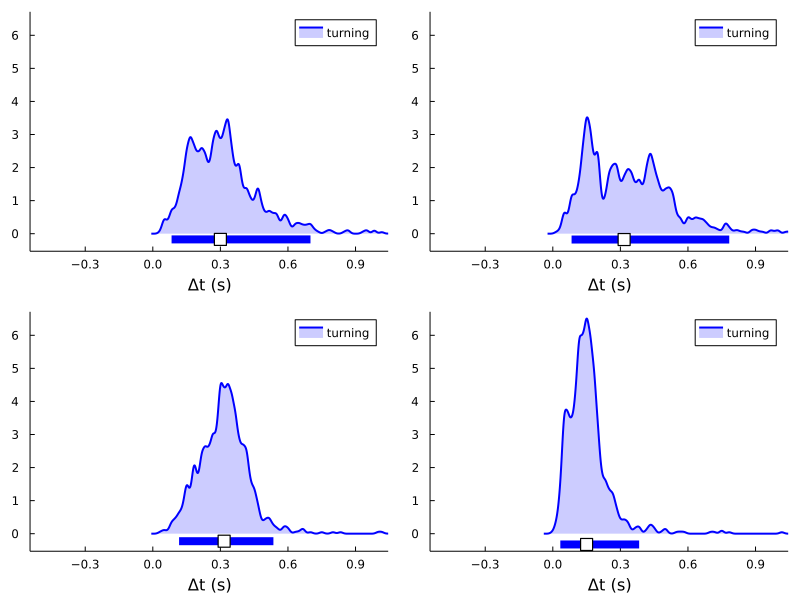

In [9]:
plots = []

for idx in 1:4
    turning = filterdf(df, "curve_id", idx, "class", "turning")
    curve_s = map(idx -> curves[idx].s, turning.curve_id)
    turning[:, "Δs"] = curve_s .- turning.s
    curve = curves[idx]

    T = []
    for (n, trial) in enumerate(trials)
        _, _, start, stop = get_curve_indices(trial, curve.tpos, curve.sf)
        ω = movingaverage(trial.ω, 2) .* curve.direction
        t = argmax(ω[start:stop]) + start
        entry = filterdf(turning, "trial_num", n)
        size(entry, 1) == 0 && continue
        push!(T, (t - entry.tpeak[1])/60)
    end

    plt = plot_kde_and_CI(T, bandwidth = .01, color="blue", label="turning")
    push!(plots, plt)
end

fig = plot(plots...; size=(800, 600), link=:all, grid=false, xlim=[-.5, 1], xlabel="Δt (s)")


given this information compute the angular acceleration the mice should have to make the turn:
$$
\theta = \theta_0 + \omega\_0t + 1/2\alpha t^2
$$

which means that
$$
\alpha = \frac{2}{t^2} (\theta - \theta_0 - \omega t)
$$

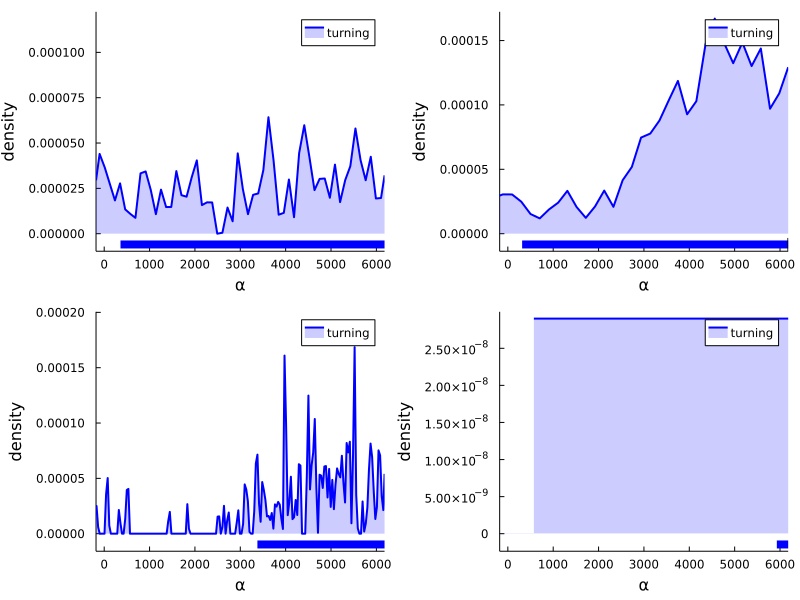

In [10]:
alpha(θ, θ_0, ω, t) = 2/t^2 * (θ - θ_0 - ω*t)

plots = []

for idx in 1:4
    turning = filterdf(df, "curve_id", idx, "class", "turning")
    curve_s = map(idx -> curves[idx].s, turning.curve_id)
    turning[:, "Δs"] = curve_s .- turning.s
    turning[:, "Δt"] = turning.Δs ./ turning.u

    θ = [45, 45, 45, 45/2][idx]
    # θ = deg2rad(θ)

    turning[:, "α"] = alpha.(θ, 0, abs.(rad2deg.(turning.ω)), turning.Δt ./ 2)

    plt = plot_kde_and_CI(turning.α, bandwidth = .1, color="blue", label="turning")
    push!(plots, plt)
end

fig = plot(plots...; size=(800, 600),  grid=false,  xlabel="α", ylabel="density", xlim=[0, 6000])


# F5
Analyse position at slowing down vs deceleration

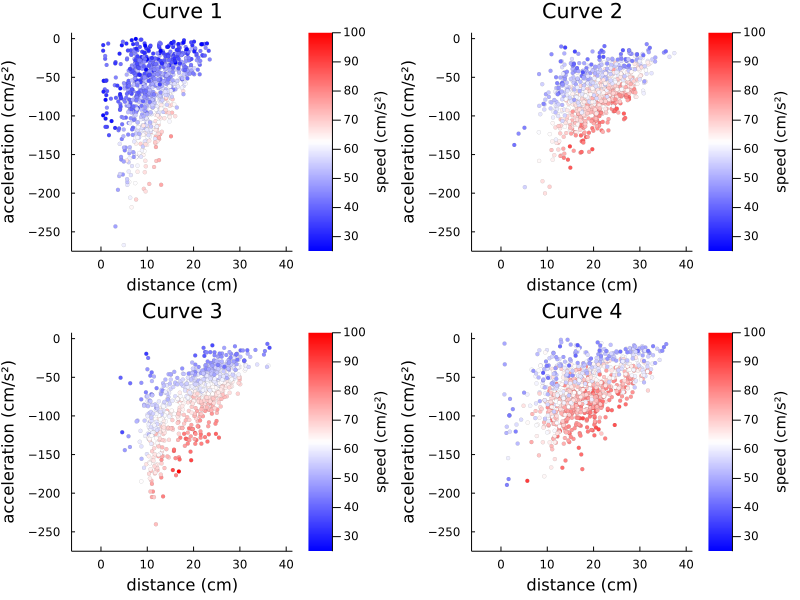

In [11]:
slowing = filterdf(df, "class", "slowing")

plots = []

for curve_idx in 1:4
    slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    curve_s = map(idx -> curves[idx].s, slowing.curve_id)
    slowing[:, "Δs"] = curve_s .- slowing.s


    plt = scatter(
        slowing.Δs, slowing.u̇, marker_z=slowing.u, c=:bwr, alpha=1, msw=0.0, label=nothing, ms=3, clims=(25, 100)
    )
    
    plot!(; xlabel="distance (cm)", ylabel="acceleration (cm/s²)", title="Curve $curve_idx", xlim=[-5, 40], legend=false, colorbar_title="speed (cm/s²)")

    push!(plots, plt)
end

fig = plot(plots...; size=(800, 600), link=:all, grid=false)
savefig(fig, joinpath(PLOTS_FOLDER, "slow_u_udot_scatter.svg"))
fig



same polot but pooling the data

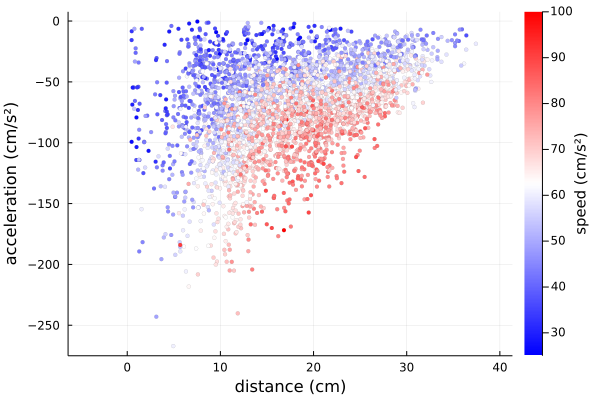

In [12]:
slowing = filterdf(df, "class", "slowing")

ds = []
for curve_idx in 1:4
    curve_slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    curve_s = map(idx -> curves[idx].s, curve_slowing.curve_id)
    append!(ds, curve_s .- curve_slowing.s)
end
slowing[:, "Δs"] = Vector{Float64}(ds)
    

plt = scatter(
    slowing.Δs, slowing.u̇, marker_z=slowing.u, c=:bwr, alpha=1, msw=0.0, label=nothing, ms=3, clims=(25, 100)
)

plot!(; xlabel="distance (cm)", ylabel="acceleration (cm/s²)", xlim=[-5, 40], legend=false, colorbar_title="speed (cm/s²)")
savefig(plt, joinpath(PLOTS_FOLDER, "slow_u_udot_scatter_pooled.svg"))
plt


## Linear model

In [13]:
# Train test split
slowing = filter(:u̇ => !isnan, slowing)

train, test = TrainTestSplit(slowing, .75)

# fit model
fm = @formula(u̇ ~ u + Δs)
linearRegressor = lm(fm, train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

u̇ ~ 1 + u + Δs

Coefficients:
─────────────────────────────────────────────────────────────────────────
                Coef.  Std. Error       t  Pr(>|t|)  Lower 95%  Upper 95%
─────────────────────────────────────────────────────────────────────────
(Intercept)  -6.23293   2.33076     -2.67    0.0075  -10.8031    -1.66272
u            -1.90329   0.0385245  -49.40    <1e-99   -1.97883   -1.82775
Δs            2.98007   0.0672249   44.33    <1e-99    2.84825    3.11189
─────────────────────────────────────────────────────────────────────────

In [14]:
r2(linearRegressor)

0.5526054258634423

In [15]:
# Prediction
ypredicted_test = predict(linearRegressor, test)
ypredicted_train = predict(linearRegressor, train)

# Test Performance DataFrame (compute squared error)
performance_testdf = DataFrame(y_actual = test[!,:u̇], y_predicted = ypredicted_test)
performance_testdf.error = performance_testdf[!,:y_actual] - performance_testdf[!,:y_predicted]
performance_testdf.error_sq = performance_testdf.error.^2

# # Train Performance DataFrame (compute squared error)
# performance_traindf = DataFrame(y_actual = train[!,:u̇], y_predicted = ypredicted_train)
# performance_traindf.error = performance_traindf[!,:y_actual] - performance_traindf[!,:y_predicted]
# performance_traindf.error_sq = performance_traindf.error.^2

# Test Error
println("Mean Absolute test error: ",mean(abs.(performance_testdf.error)), "\n")
println("Mean square test error: ", mean(performance_testdf.error_sq), "\n")

Mean Absolute test error: 17.54257819633512

Mean square test error: 606.5412383068083



## Deceleration analysis
Compare $\Delta t$ to the max deceleration that mice can do. Start by estimating that from the tracking data

Max deceleration: -193.0 m/s²

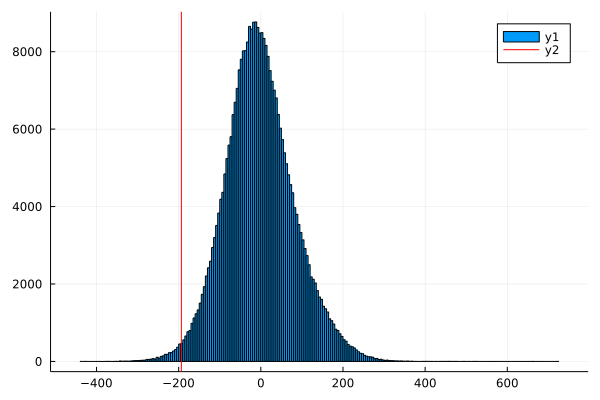

In [16]:
# Estimate mice's acceleration
accelerations = vcat(map(t->diff(movingaverage(t.u, 11)), trials)...) * 60
max_accel = percentile(accelerations, 1)

plt = histogram(accelerations)
vline!([max_accel], color="red")

print("Max deceleration: $(round(max_accel)) m/s²")
plt

In [17]:
# compute change in speed and change in time at each curve
Δ_speed, Δ_t = [], []
for curve_idx in 1:4
    slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    turning = filterdf(df, "curve_id", curve_idx, "class", "turning")

    push!(Δ_speed, turning.u .- slowing.u)
    push!(Δ_t, (turning.tpeak .- slowing.tpeak) ./ 60)
end


plot the change in speed over time vs the max possible acceleration

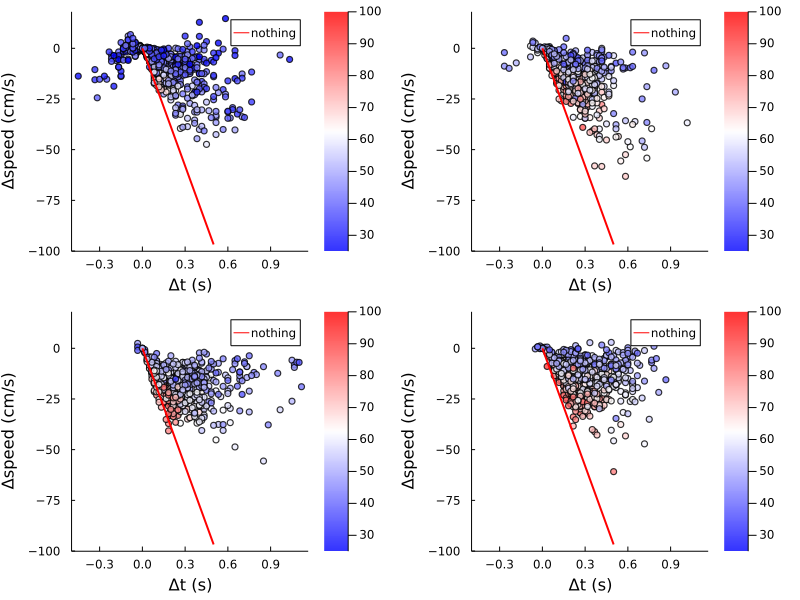

In [18]:
plots = []

for i in 1:4
    slowing = filterdf(df, "curve_id", i, "class", "slowing")

    plt = scatter(Δ_t[i], Δ_speed[i],  marker_z=slowing.u, c=:bwr, alpha=.8, label=nothing, xlabel = "Δt (s)", ylabel = "Δspeed (cm/s)")

    # plot a line marking max deceleration
    plot!(
        [0, .5], [0*max_accel, .5*max_accel], lw=2, color="red", label="nothing", clims=(25, 100)
    )

    push!(plots, plt)
end

fig = plot(plots...; size=(800, 600), link=:all, grid=false)
savefig(fig, joinpath(PLOTS_FOLDER, "slow_turn_Δt_Δs_acc.svg"))
fig

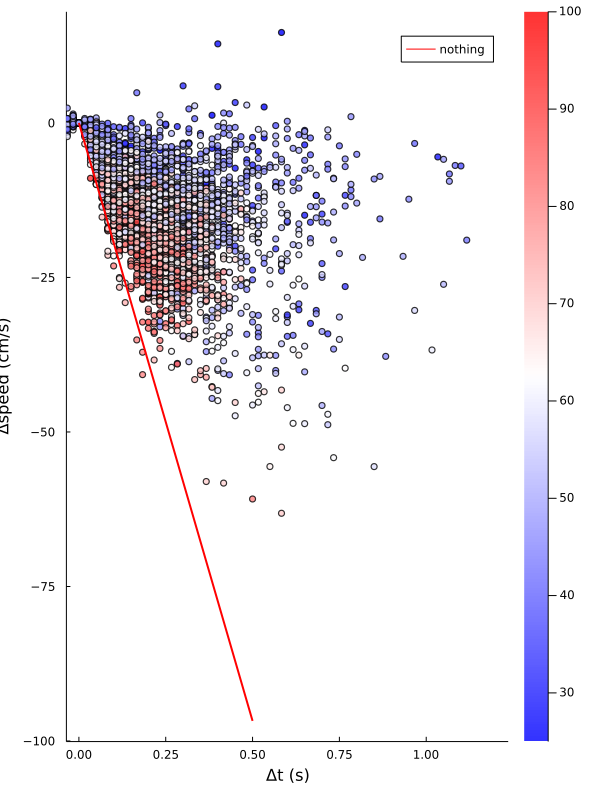

In [19]:
# same but for all data
slowing = filterdf(df, "class", "slowing")

ds = []
for curve_idx in 1:4
    curve_slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    curve_s = map(idx -> curves[idx].s, curve_slowing.curve_id)
    append!(ds, curve_s .- curve_slowing.s)
end
slowing[:, "Δs"] = Vector{Float64}(ds)
    

# the same but plot all curves together
plt = scatter(vcat(Δ_t...), vcat(Δ_speed...),  marker_z=slowing.u, c=:bwr, alpha=.8,   label=nothing, xlabel = "Δt (s)", ylabel = "Δspeed (cm/s)", clims=(25, 100))

plot!(
    [0, .5], [0*max_accel, .5*max_accel], lw=2, color="red", label="nothing"
)

plot!(; xlim=[0, 1.2], grid=false, size=(600, 800))

savefig(plt, joinpath(PLOTS_FOLDER, "slow_turn_Δt_Δs_acc_pooled.svg"))
plt

# Error trials (F5)

Start by looking at the kinematics of mice as they are about to start each curve and look how that affects the trajectory

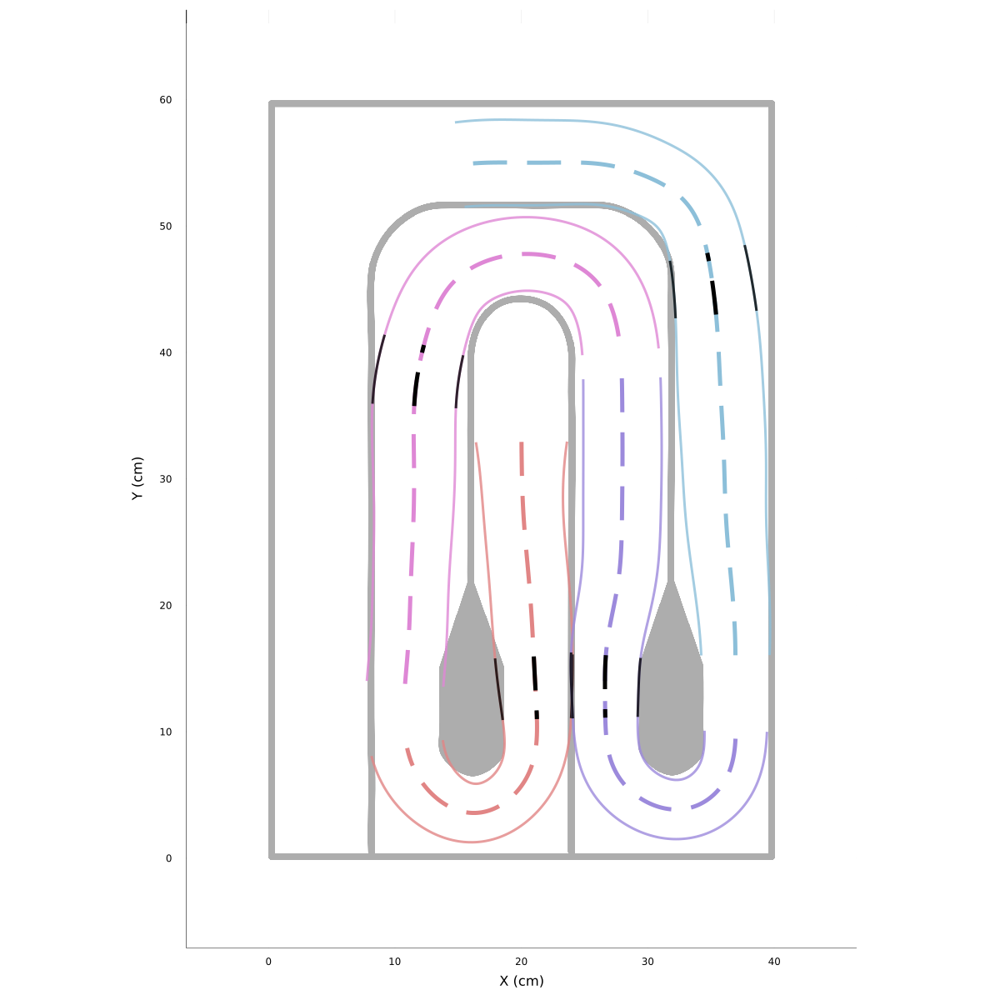

In [54]:
# define ROIs (boxes, 5cm long) at start of each curve
Δ_s = Dict{String, Int}(
    "first" => 15, 
    "second" => 17,
    "third" => 15,
    "fourth" => 10
)


"""
Get frames indices when a mouse goes through a curve's box (start/stop)
"""
function through_box(trial, curve)
    s0 = curve.s - Δ_s[curve.name]
    s1 = curve.s - Δ_s[curve.name] + 5

    start = findlast(trial.s .< s0)
    start = isnothing(start) ? 1 : start
    start += 2

    stop = findfirst(trial.s[start:end] .>= s1) + start
    stop = isnothing(stop) ? length(trial.s) : stop
    # stop -= 2
    return start, stop
end


# plot boxes over each curve
fig = draw(:arena)
for (i, curve) in enumerate(curves)
    track = jc.trim(FULLTRACK, curve.s0, curve.sf-curve.s0)
    draw!(track, color=curves_colors[i], Δp=50, alpha=1)

    # box = ComparisonPoints(FULLTRACK, [s-5, s-10])
    track = jc.trim(FULLTRACK, curve.s - Δ_s[curve.name], 5)
    draw!(track, color="black", Δp=50, alpha=1)
end

fig

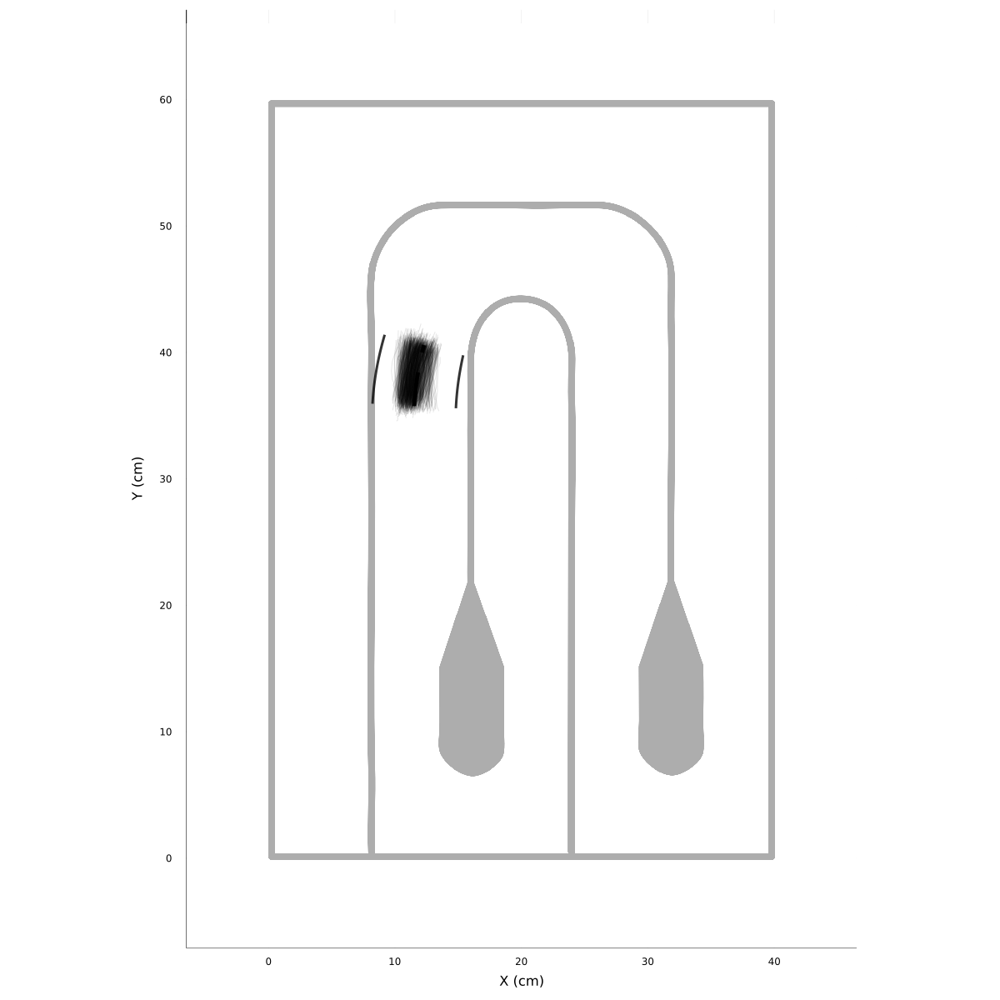

In [55]:
# check everything's fine so far
plt = draw(:arena)

curve = curves[2]
track = jc.trim(FULLTRACK, curve.s - Δ_s[curve.name], 5)
draw!(track, color="black", Δp=50, alpha=1)

for trial in trials
    start, stop = through_box(trial, curve)
    plot!(trial.x[start:stop], trial.y[start:stop], color="black", alpha=.1, label=nothing)
end

plt


plot KDes of kinematic variables through box

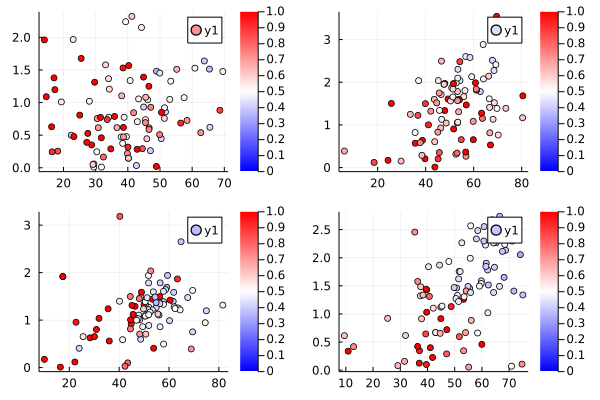

In [84]:
plots = []

for i in 1:4
    curve = curves[i]

    _u, _ω, _duration = [], [], []
    for trial in trials
        start, stop = through_box(trial, curve)
        _, _, _curv_start, _curv_stop = get_curve_indices(trial, curve.s0, curve.sf)

        push!(_u, mean(trial.u[start:stop]))
        push!(_ω, mean(trial.ω[start:stop]))
        push!(_duration, (_curv_stop - stop)/60)
    end

    # p1 = plot_kde_and_CI(_u; color="green",)
    # plot!(title=curve.name)
    # push!(plots, p1)
    # p2 = plot_kde_and_CI(_ω; bandwidth=.1)
    # push!(plots, p2)

    plt = scatter(_u, abs.(_ω), marker_z=_duration, c=:bwr, clims=(0, 1))
    # plt = scatter(_duration, _u,c=:bwr)

    push!(plots, plt)
end

plot(plots...)